In [72]:
import os
import numpy as np
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point, Polygon
import matplotlib.pyplot as plt
import warnings

warnings.filterwarnings("ignore")

In [89]:
lag = 1

In [73]:
# Load the shp file
oklahoma_map = gpd.read_file('Igismap/UnitedStates_Boundary.shp')

In [74]:
# earthquake data
inputdir = "datasets/EarthquakeData"
all_earthquake_df = pd.DataFrame()

for root, dirnames, filenames in os.walk(inputdir):
    for filename in filenames:
        df = pd.read_csv(os.path.join(root, filename))
        all_earthquake_df = all_earthquake_df.append(df, ignore_index=True)

In [75]:
# set origintime as index
all_earthquake_df['origintime'] = all_earthquake_df['origintime'].astype('datetime64')
all_earthquake_df['Origin Date'] = all_earthquake_df['origintime']
all_earthquake_df = all_earthquake_df.set_index('origintime')

In [76]:
all_earthquake_df.sort_values(by='origintime')  # 2000-06-18 -- 2021-05-31

,event_id,magnitude,magnitude_source,max_mmi,latitude,longitude,depth_km,err_lat,err_lon,err_depth,err_origintime,state,county,status,Origin Date
origintime,,,,,,,,,,,,,,,
2000-06-18 15:54:30,0,2.2,OGS,None,34.917000,-98.186000,2.28,None,None,None,None,None,CADDO,None,2000-06-18 15:54:30
2000-10-08 10:16:25,0,2.4,OGS,5,35.391000,-97.941000,5.00,None,None,None,None,None,CANADIAN,None,2000-10-08 10:16:25
2000-11-10 00:14:31,0,2.4,OGS,None,35.824000,-98.255000,5.00,None,None,None,None,None,BLAINE,None,2000-11-10 00:14:31
2000-11-11 00:14:32,0,2.4,OGS,None,34.774000,-97.806000,0.98,None,None,None,None,None,GRADY,None,2000-11-11 00:14:32
2001-01-27 00:57:54,0,2.3,OGS,None,34.640000,-95.952000,5.19,None,None,None,None,None,ATOKA,None,2001-01-27 00:57:54
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-30 04:02:02,48969,2.3,OGS,None,36.532452,-98.980141,3.08,1.56,1.54,1.33,0.29056252,Oklahoma,Woodward,Preliminary,2021-05-30 04:02:02
2021-05-30 15:26:45,48978,2.4,OGS,None,35.102898,-95.335548,0.86,6.41,3.64,3.48,0.86833805,Oklahoma,Pittsburg,Preliminary,2021-05-30 15:26:45
2021-05-30 22:07:46,48985,2.3,OGS,None,34.627842,-96.307716,0.75,3.9,3.03,2.73,0.7425026,Oklahoma,Coal,Preliminary,2021-05-30 22:07:46


In [77]:
useful_earthquake_df = all_earthquake_df["2010":"2021"]

In [78]:
# 检测2011年的地震
earthquake_start = 2015
earthquake_end = 2015
earthquake_df = useful_earthquake_df[str(earthquake_start):str(earthquake_end)]
earthquake_df.shape

(7607, 15)

In [80]:
earthquake_df

,event_id,magnitude,magnitude_source,max_mmi,latitude,longitude,depth_km,err_lat,err_lon,err_depth,err_origintime,state,county,status,Origin Date
origintime,,,,,,,,,,,,,,,
2015-01-01 00:15:49,0,2.0,OGS,0,36.36558,-97.07604,5.613,0.7,1.1,2.0,0.46,None,NOBLE,None,2015-01-01 00:15:49
2015-01-01 00:26:10,0,3.0,OGS,1,36.65549,-97.63704,5.319,0.4,0.8,1.4,0.36,None,GRANT,None,2015-01-01 00:26:10
2015-01-01 04:40:19,0,2.5,OGS,0,36.67116,-97.61475,5.414,0.6,1.1,2.0,0.4,None,GRANT,None,2015-01-01 04:40:19
2015-01-01 06:25:59,0,2.1,OGS,0,35.80100,-97.56561,5.713,0.3,0.6,1.0,0.27,None,LOGAN,None,2015-01-01 06:25:59
2015-01-01 08:35:24,0,2.6,OGS,0,36.93193,-97.49207,6.829,0.7,0.9,1.5,0.39,None,GRANT,None,2015-01-01 08:35:24
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2015-12-31 18:15:57,0,2.5,OGS,0,35.66447,-97.39919,6.256,0.2,0.3,0.4,0.23,None,OKLAHOMA,None,2015-12-31 18:15:57
2015-12-31 19:34:49,0,2.2,OGS,0,35.66851,-97.39302,6.392,0.4,0.5,0.6,0.3,None,OKLAHOMA,None,2015-12-31 19:34:49
2015-12-31 20:31:14,0,2.6,OGS,0,35.78598,-97.56871,6.479,0.3,0.4,0.8,0.28,None,LOGAN,None,2015-12-31 20:31:14


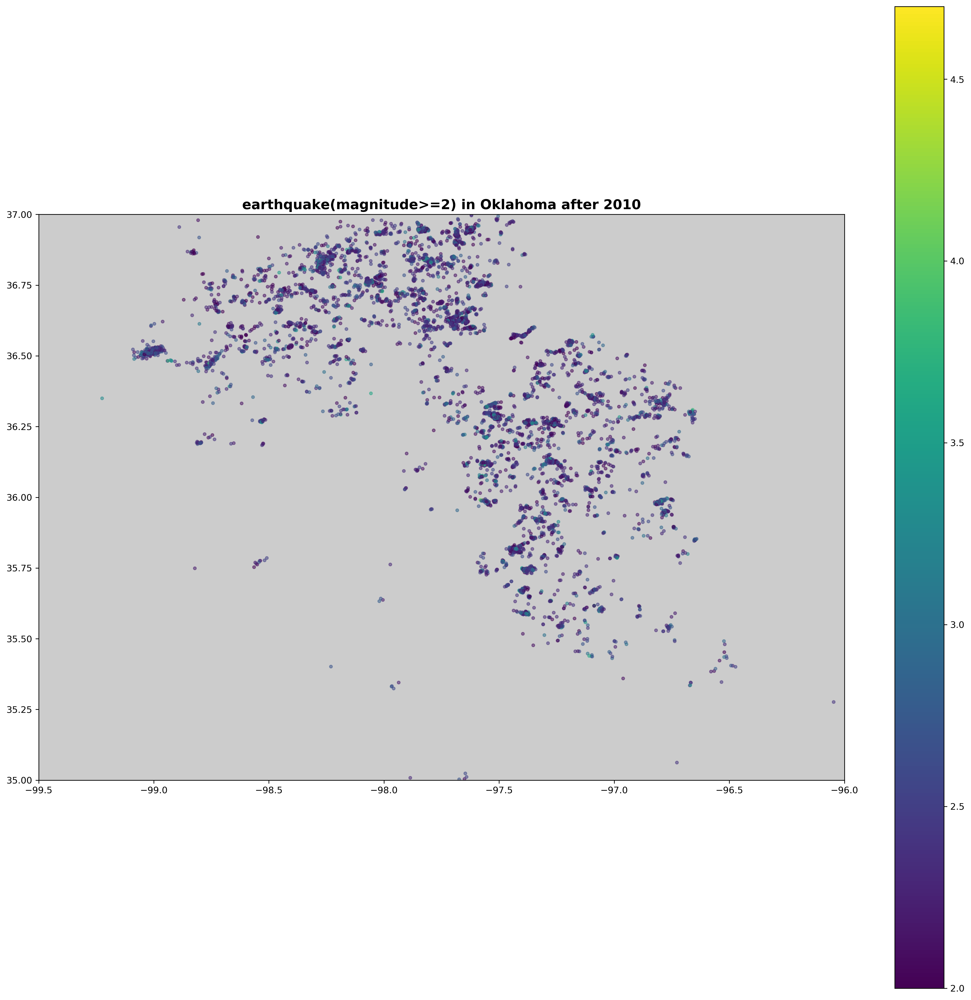

In [81]:
# zip x and y coordinates into single feature
earthquake_geometry = [Point(xy) for xy in zip(earthquake_df['longitude'], earthquake_df['latitude'])]

# create GeoPandas dataframe
earthquake_geo_df = gpd.GeoDataFrame(earthquake_df, crs = "EPSG:4326", geometry = earthquake_geometry) #4326 is the code for a lat,long coordinate system

# earthquake 分布
# create figure and axes, assign to subplot
fig, ax = plt.subplots(figsize=(20, 20), dpi=300)
# add .shp mapfile to axes
oklahoma_map.plot(ax=ax, alpha=0.4,color='grey')
# add geodataframe to axes
# assign ‘magnitude’ variable to represent coordinates on graph
# add legend
# make datapoints transparent using alpha
# assign size of points using markersize
earthquake_geo_df.plot(column='magnitude',ax=ax, alpha=0.5, legend=True, markersize=10)
# add title to graph
plt.title('earthquake(magnitude>=2) in Oklahoma after ' + start, fontsize=15,fontweight='bold')
# set latitiude and longitude boundaries for map display
plt.xlim(-99.5, -96)
plt.ylim(35, 37)
# plt.xlim(-98, -97.5)
# plt.ylim(36.5, 37)
# show map
plt.show()

# Year injection

In [84]:
# injection data
inputdir = "datasets/OCC_injection_data/YearlyInjectionRecords"
# inputdir = "datasets/OCC_injection_data/MonthlyInjectionRecords"
yearly_injection_df = pd.DataFrame()

for root, dirnames, filenames in os.walk(inputdir):
    for filename in filenames:
        df = pd.read_excel(os.path.join(root, filename))
        yearly_injection_df = yearly_injection_df.append(df, ignore_index=True)

In [85]:
yearly_injection_df['Year Vol'] = yearly_injection_df['Jan Vol'] + \
                                yearly_injection_df['Feb Vol'] + \
                                yearly_injection_df['Mar Vol'] + \
                                yearly_injection_df['Apr Vol'] + \
                                yearly_injection_df['May Vol'] + \
                                yearly_injection_df['Jun Vol'] + \
                                yearly_injection_df['Jul Vol'] + \
                                yearly_injection_df['Aug Vol'] + \
                                yearly_injection_df['Sep Vol'] + \
                                yearly_injection_df['Oct Vol'] + \
                                yearly_injection_df['Nov Vol'] + \
                                yearly_injection_df['Dec Vol']

yearly_injection_df = yearly_injection_df.dropna(subset=["LAT", "LON"])

In [86]:
# Set Report_Date as index
yearly_injection_df['ReportYear'] = yearly_injection_df['ReportYear'].astype('datetime64')
yearly_injection_df['Report Date'] = yearly_injection_df['ReportYear']
yearly_injection_df = yearly_injection_df.set_index('ReportYear')

In [88]:
yearly_injection_df.sort_values(by='ReportYear') # 2011-01-01 -- 2019-07-01

,API,OperatorName,WellName,WellNumber,Status,WellStatus,WellType,LAT,LON,County,...,Sep Vol,Sep PSI,Oct Vol,Oct PSI,Nov Vol,Nov PSI,Dec Vol,Dec PSI,Year Vol,Report Date
ReportYear,,,,,,,,,,,,,,,,,,,,,
2011-01-01,3514727816,GATEWAY RESOURCES USA INC,RALPH WILLIAMS SWD,60,OPEN,AC,2DNC,36.454506,-95.975436,WASHINGTON,...,11171.0,0.0,12417.0,0.0,10710.0,0.0,11804.0,0.0,131799.0,2011-01-01
2011-01-01,3512302139,CITATION OIL & GAS CORPORATION,EAST FITTS UNIT,14A1-1,OPEN,AC,2RIn,34.625888,-96.538393,PONTOTOC,...,5553.0,1500.0,5043.0,1475.0,3137.0,1475.0,4786.0,1475.0,18519.0,2011-01-01
2011-01-01,3512302151,CITATION OIL & GAS CORPORATION,EAST FITTS UNIT (BATES A#1),25A-1A,OPEN,AC,2RIn,34.619141,-96.548243,PONTOTOC,...,49975.0,1550.0,46022.0,1450.0,47051.0,1550.0,48184.0,1550.0,603597.0,2011-01-01
2011-01-01,3512302159,7C LAND & MINERALS CO,BLANKENSHIP GIBBONS,1,OPEN,AC,2DNC,34.590318,-96.616073,PONTOTOC,...,2400.0,0.0,2480.0,0.0,2400.0,0.0,2480.0,0.0,29200.0,2011-01-01
2011-01-01,3512302167,FDL OPERATING LLC,FITTS WEST UNIT (SHAFFER 6) (FWU 1111),20-6,OPEN,AC,2RIn,34.617289,-96.629317,PONTOTOC,...,30383.0,1416.0,32543.0,1378.0,33772.0,1349.0,34403.0,1344.0,256057.0,2011-01-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-07-01,3507124656,TONKAWA SALTWATER DISPOSAL LLC,TONKAWA SWD,1,OPEN,ACRT,2DCm,36.691437,-97.292599,KAY,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2019-07-01
2019-07-01,3513720816,JOHNSON OIL COMPANY INC,EVWBSSU,S-5,OPEN,AC,2DCm,34.444030,-97.587450,STEPHENS,...,36423.0,0.0,27634.0,0.0,21472.0,0.0,18347.0,0.0,253829.0,2019-07-01
2019-07-01,3505124403,KYBENCO DISPOSALS LLC,GRACY SWD,1,OPEN,AC,2DCm,35.175349,-97.770231,GRADY,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2019-07-01


In [90]:
# injection_df = monthly_injection_df
injection_start = earthquake_start - lag
injection_end = earthquake_end - lag
injection_df = yearly_injection_df.loc[str(injection_start):str(injection_end)]

In [91]:
injection_df

,API,OperatorName,WellName,WellNumber,Status,WellStatus,WellType,LAT,LON,County,...,Sep Vol,Sep PSI,Oct Vol,Oct PSI,Nov Vol,Nov PSI,Dec Vol,Dec PSI,Year Vol,Report Date
ReportYear,,,,,,,,,,,,,,,,,,,,,
2014-01-01,3500300026,PHOENIX PETROCORP INC,SE EUREKA UNIT-TUCKER #1,21,OPEN,AC,2RIn,36.900396,-98.219252,ALFALFA,...,1102.0,500.0,547.0,500.0,546.0,500.0,521.0,500.0,10165.0,2014-01-01
2014-01-01,3500300163,SUPERIOR PRODUCTION LLC,CHRISTENSEN,1,OPEN,AC,2RIn,36.896636,-98.177720,ALFALFA,...,1063.0,200.0,973.0,200.0,1063.0,200.0,778.0,200.0,12097.0,2014-01-01
2014-01-01,3500320145,CONTINENTAL RESOURCES INC,SINGREE,1,OPEN,PA,TM,36.504849,-98.433240,ALFALFA,...,3527.0,170.0,5303.0,200.0,4839.0,170.0,8508.0,190.0,52241.0,2014-01-01
2014-01-01,3500320786,BLACK ANVIL OPERATING LLC,NE CHEROKEE UNIT,85,OPEN,TA,TM,36.806113,-98.325840,ALFALFA,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2014-01-01
2014-01-01,3500320929,CHAPARRAL ENERGY LLC,R & H,1,OPEN,PA,TM,36.962410,-98.519482,ALFALFA,...,582.0,0.0,300.0,0.0,300.0,0.0,221.0,0.0,8358.0,2014-01-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2014-01-01,3515323353,WHEELER ENERGY LLC,MCGOU 'A',1-27,OPEN,AC,2RIn,36.262634,-99.548620,WOODWARD,...,6048.0,1608.0,5908.0,1576.0,4695.0,1542.0,5848.0,1710.0,60982.0,2014-01-01
2014-01-01,3515323377,WOODWARD IODINE CORPORATION,WOODWARD IODINE,45,OPEN,AC,2DNC,36.520570,-99.334540,WOODWARD,...,12343.0,610.0,55269.0,787.0,184114.0,1000.0,110537.0,905.0,1594663.0,2014-01-01
2014-01-01,3515323424,WOODWARD IODINE CORPORATION,CEI SWD,24-1,OPEN,AC,2DNC,36.276890,-99.298870,WOODWARD,...,12314.0,0.0,7651.0,7.0,6283.0,12.0,16155.0,0.0,149242.0,2014-01-01


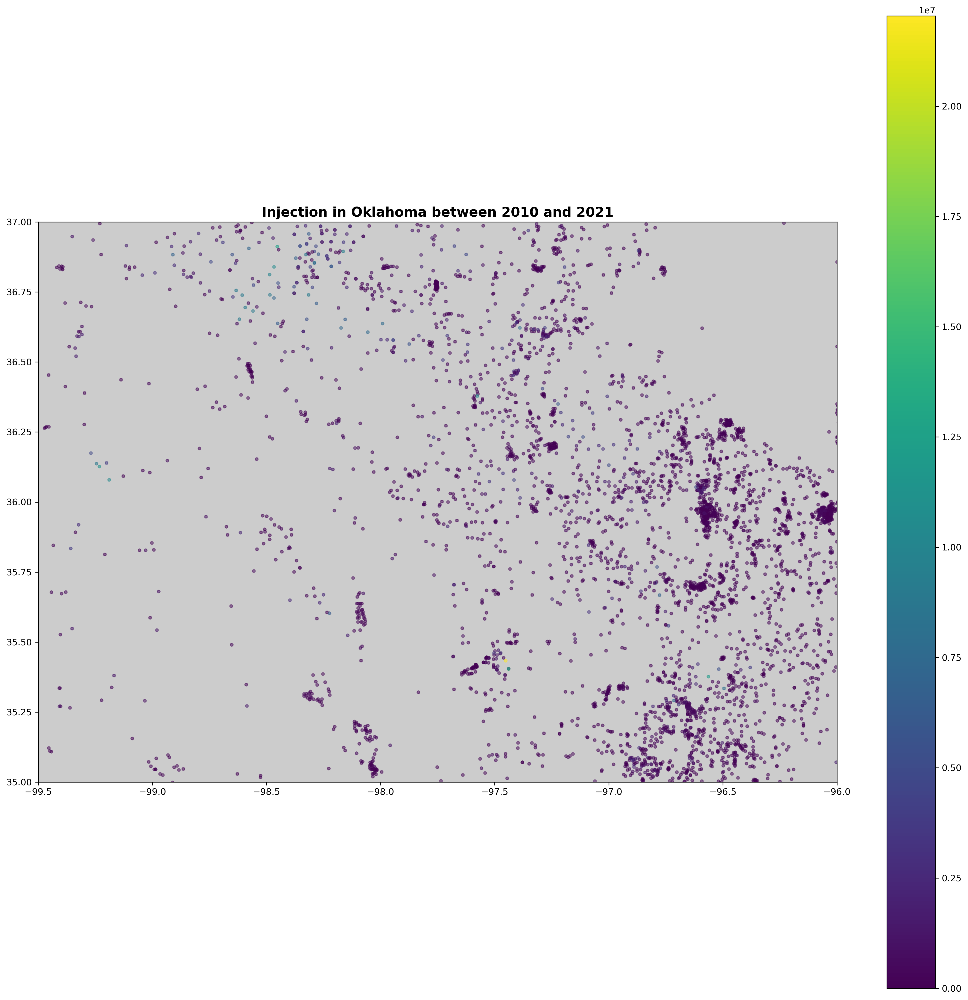

In [92]:
# zip x and y coordinates into single feature
injection_geometry = [Point(xy) for xy in zip(injection_df['LON'], injection_df['LAT'])]

# create GeoPandas dataframe
injection_geo_df = gpd.GeoDataFrame(injection_df, crs = "EPSG:4326", geometry = injection_geometry)

# Injection 分布
# create figure and axes, assign to subplot
fig, ax = plt.subplots(figsize=(20, 20), dpi=300)
# add .shp mapfile to axes
oklahoma_map.plot(ax=ax, alpha=0.4,color='grey')
# add geodataframe to axes
# assign ‘Volume_BPD’ variaable to represent coordinates on graph
# add legend
# make datapoints transparent using alpha
# assign size of points using markersize
injection_geo_df.plot(column='Year Vol',ax=ax, alpha=0.5, legend=True, markersize=10)
# add title to graph
plt.title('Injection in Oklahoma between '+start+' and '+end, fontsize=15,fontweight='bold')
# set latitiude and longitude boundaries for map display
plt.xlim(-99.5, -96)
plt.ylim(35, 37)
# plt.xlim(-98, -97.5)
# plt.ylim(36.5, 37)
# show map
plt.show()

# well

In [93]:
inputdir = "datasets/WellData/"
all_well_df = pd.read_csv(inputdir + "Export - Excel Well Workbook_Header.csv")

In [94]:
all_well_df = all_well_df.dropna(subset=["Permit Date", 'Date First Report', 'Date Last Activity', "Depth Total Projected", "Surface Latitude", "Surface Longitude"])
all_well_df = all_well_df.set_index('Permit Date')
all_well_df['Date First Report'] = all_well_df['Date First Report'].astype('datetime64')
all_well_df['Date Last Activity'] = all_well_df['Date Last Activity'].astype('datetime64')

In [95]:
all_well_df

,UWI,Source,API Number,IC Number,Regulatory API,Operator Name,Operator City,Current Operator Name,Current Operator City,Lease Name,...,Surface LL Source,Proposed BH Latitude,Proposed BH Longitude,Proposed BH LL Source,BH Latitude,BH Longitude,BH LL Source,Activity Code,Permit Filer Long,Permit Phone
Permit Date,,,,,,,,,,,,,,,,,,,,,
04/08/1978,3.508320e+13,PI,3.508320e+13,NaN,3.508321e+09,MOORE REX R JR,NaN,MOORE REX R JR,NaN,WYATT `A`UNIT,...,IH,NaN,NaN,NaN,NaN,NaN,NaN,E,NaN,NaN
07/08/1978,3.508320e+13,PI,3.508320e+13,NaN,3.508321e+09,HADSON OHIO OIL CO,NaN,HADSON OHIO OIL CO,NaN,KIRKPATRICK,...,IH,NaN,NaN,NaN,NaN,NaN,NaN,E,NaN,NaN
28/07/1978,3.508320e+13,PI,3.508320e+13,NaN,NaN,LOBAR OIL CO INC,NaN,LOBAR OIL CO INC,NaN,DENNY,...,IH,NaN,NaN,NaN,NaN,NaN,NaN,D,NaN,NaN
09/08/1978,3.508320e+13,PI,3.508320e+13,NaN,NaN,BLAIK OIL CO,NaN,BLAIK OIL CO,NaN,WALL,...,IH,NaN,NaN,NaN,NaN,NaN,NaN,D,NaN,NaN
08/08/1978,3.508320e+13,PI,3.508320e+13,NaN,3.508321e+09,MOORE REX R JR,NaN,MOORE REX R JR,NaN,WYATT UNIT,...,IH,NaN,NaN,NaN,NaN,NaN,NaN,E,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18/08/1974,3.514920e+13,PI,3.514920e+13,NaN,NaN,PHILLIPS PETROLEUM CO,NaN,PHILLIPS PETROLEUM CO,NaN,LUEKENGA /A/,...,IH,NaN,NaN,NaN,NaN,NaN,NaN,D,NaN,NaN
30/09/1974,3.514920e+13,PI,3.514920e+13,NaN,NaN,ENSERCH EXPLORATION INC,NaN,ENSERCH EXPLORATION INC,NaN,ADA STINSON,...,IH,NaN,NaN,NaN,NaN,NaN,NaN,D,NaN,NaN
23/11/1974,3.514920e+13,PI,3.514920e+13,NaN,NaN,EL PASO NATURAL GAS CO,NaN,BURLINGTON RESOURCES O&G CO LP,NaN,PIERCE WILLIE `A`,...,IH,NaN,NaN,NaN,NaN,NaN,NaN,D,NaN,NaN


In [96]:
well_start = earthquake_start - lag
well_df = all_well_df[all_well_df['Date Last Activity']>str(well_start)]

In [97]:
# 指定时间范围还处于活动的油井
well_df[['Date First Report', 'Date Last Activity']]

,Date First Report,Date Last Activity
Permit Date,,
04/08/1978,1978-08-18,2015-09-01
07/08/1978,1978-08-18,2015-01-29
28/07/1978,1979-01-01,2019-06-25
09/08/1978,1979-01-01,2018-08-06
08/08/1978,1978-08-18,2015-02-17
...,...,...
18/08/1974,1975-01-03,2018-08-06
30/09/1974,1976-01-03,2018-08-06
23/11/1974,1977-01-01,2018-08-20


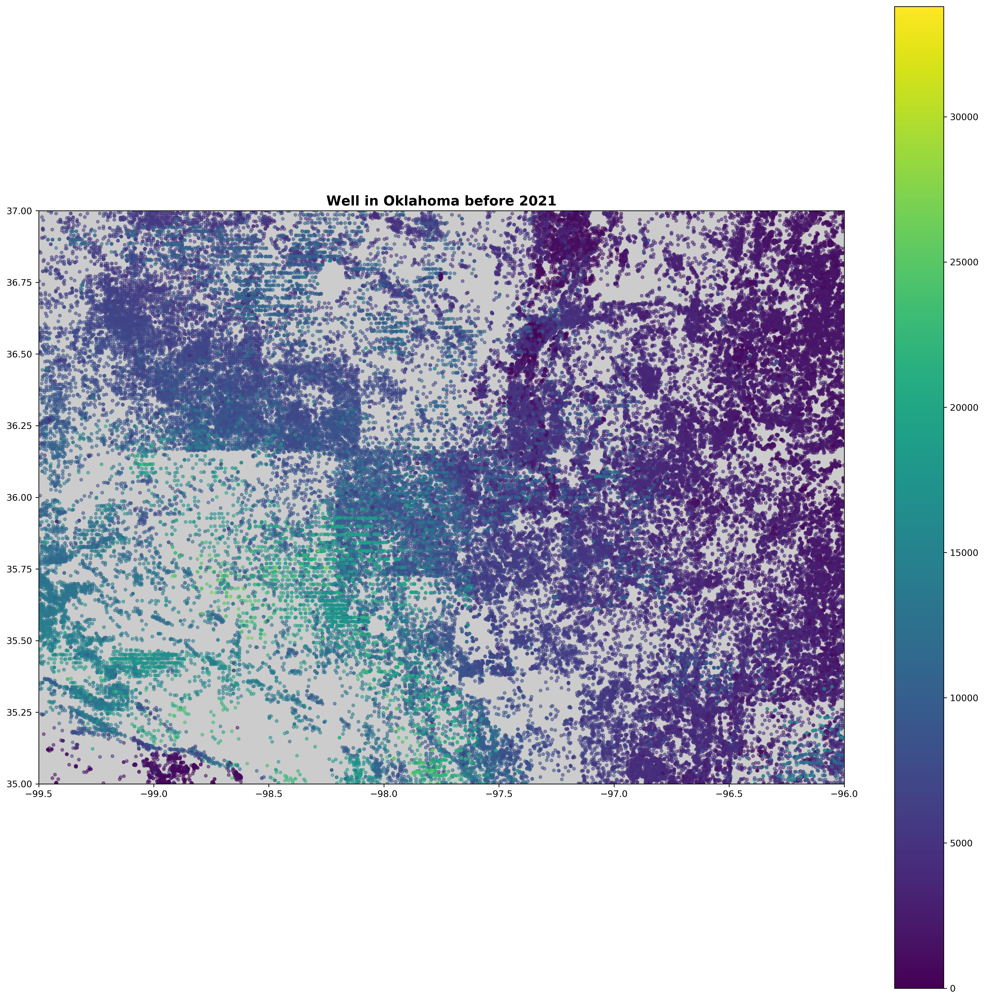

In [98]:
# zip x and y coordinates into single feature
well_geometry = [Point(xy) for xy in zip(well_df['Surface Longitude'], well_df['Surface Latitude'])]

# create GeoPandas dataframe
well_geo_df = gpd.GeoDataFrame(well_df, crs = "EPSG:4326", geometry = well_geometry)

# well 分布
# create figure and axes, assign to subplot
fig, ax = plt.subplots(figsize=(20, 20), dpi=300)
# add .shp mapfile to axes
oklahoma_map.plot(ax=ax, alpha=0.4,color='grey')
# add geodataframe to axes
# assign ‘Depth Total Projected’ variable to represent coordinates on graph
# add legend
# make datapoints transparent using alpha
# assign size of points using markersize
well_geo_df.plot(column='Depth Total Projected',ax=ax, alpha=0.5, legend=True, markersize=10)
# add title to graph
plt.title('Well in Oklahoma before ' + end, fontsize=15,fontweight='bold')
# set latitiude and longitude boundaries for map display
plt.xlim(-99.5, -96)
plt.ylim(35, 37)
# plt.xlim(-98, -97.5)
# plt.ylim(36.5, 37)
# show map
plt.show()

In [358]:
# import geopy.distance
# geopy.distance.geodesic([36.5, -98],[37, -98])

In [99]:
# 筛选出指定区域内的well
# well_geo_df_subarea = well_geo_df.copy(deep=True)
# earthquake_geo_df_subarea = earthquake_geo_df.copy(deep=True)
# injection_geo_df_subarea = injection_geo_df.copy(deep=True)

well_geo_df_subarea = well_geo_df[(well_geo_df['Surface Latitude']>36)&(well_geo_df['Surface Latitude']<37)&(well_geo_df['Surface Longitude']>-98)&(well_geo_df['Surface Longitude']<-97)]
earthquake_geo_df_subarea = earthquake_geo_df[(earthquake_geo_df['latitude']>36)&(earthquake_geo_df['latitude']<37)&(earthquake_geo_df['longitude']>-98)&(earthquake_geo_df['longitude']<-97)]
injection_geo_df_subarea = injection_geo_df[(injection_geo_df['LAT']>36)&(injection_geo_df['LAT']<37)&(injection_geo_df['LON']>-98)&(injection_geo_df['LON']<-97)]

In [100]:
earthquake_geo_df_subarea = earthquake_geo_df_subarea.to_crs({'init': 'epsg:3081'})  # Define crs for our geodataframe
injection_geo_df_subarea = injection_geo_df_subarea.to_crs({'init':'epsg:3081'})
well_geo_df_subarea = well_geo_df_subarea.to_crs({'init':'epsg:3081'})

In [101]:
print(well_geo_df_subarea.shape)
print(injection_geo_df_subarea.shape)
print(earthquake_geo_df_subarea.shape)

(16084, 77)
(796, 58)
(3819, 16)


In [64]:
# !pip install pandarallel
# # Import
# from pandarallel import pandarallel

# # Initialization
# pandarallel.initialize()

In [102]:
earthquake_well_list = []
# iterate over all the wells in the given area
iter_num = 0
for index_earthquake, row_earthquake in earthquake_geo_df_subarea.iterrows():
    earthquake = row_earthquake['geometry']
    # calculate the distance for all wells according to this earthquake
    well_geo_df_subarea['distance']= pow((well_geo_df_subarea['geometry'].x - earthquake.x)**2 + (well_geo_df_subarea['geometry'].y - earthquake.y)**2, 0.5)
    # filter wells operated before earthquake
    well = well_geo_df_subarea[(well_geo_df_subarea['Date First Report']<row_earthquake['Origin Date']) & (well_geo_df_subarea['Date Last Activity']>row_earthquake['Origin Date'])]
    # count the amount of wells
    well_number = len(well[well['distance']<1000])
    earthquake_well_list.append(well_number)
    iter_num = iter_num + 1
    if iter_num % 1000 == 0:
        print(round(iter_num / earthquake_geo_df_subarea.shape[0] * 100, 2), "%")

earthquake_geo_df_subarea.loc[:,'well number'] = earthquake_well_list

26.18 %
52.37 %
78.55 %


In [103]:
earthquake_injection_list = []

iter_num = 0
# iterate over all the wells in the given area
for index_earthquake, row_earthquake in earthquake_geo_df_subarea.iterrows():
    earthquake = row_earthquake['geometry']
    # calculate the distance for all injections according to this earthquake
    injection_geo_df_subarea['distance']= pow((injection_geo_df_subarea['geometry'].x - earthquake.x)**2 + (injection_geo_df_subarea['geometry'].y - earthquake.y)**2, 0.5)
    # filter injections before earthquake
    injection = injection_geo_df_subarea[injection_geo_df_subarea['Report Date']<row_earthquake['Origin Date']]
    # count the volume of injections
    injection_volume = injection[injection['distance']<1000]['Year Vol'].sum()
    earthquake_injection_list.append(injection_volume)
    iter_num = iter_num + 1
    if iter_num % 1000 == 0:
        print(round(iter_num / earthquake_geo_df_subarea.shape[0] * 100, 2), "%")

earthquake_geo_df_subarea.loc[:,'injection volume'] = earthquake_injection_list

26.18 %
52.37 %
78.55 %


In [104]:
data = earthquake_geo_df_subarea[['well number', 'injection volume', 'magnitude']]

In [105]:
data

,well number,injection volume,magnitude
origintime,,,
2015-01-01 00:15:49,1,0.0,2.0
2015-01-01 00:26:10,1,0.0,3.0
2015-01-01 04:40:19,0,0.0,2.5
2015-01-01 08:35:24,0,0.0,2.6
2015-01-01 11:11:11,13,34135.0,2.2
...,...,...,...
2015-12-29 03:49:35,0,0.0,2.2
2015-12-29 21:01:12,0,0.0,2.3
2015-12-30 05:14:50,3,0.0,2.6


# 回归

In [106]:
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

# sns.set_style(style="darkgrid")

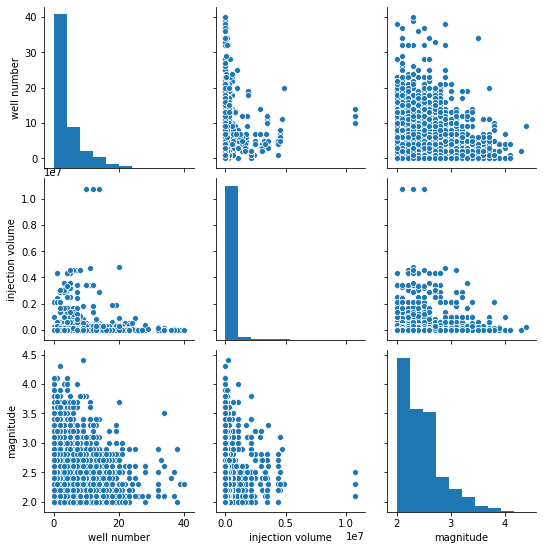

In [108]:
sns.pairplot(data)

In [109]:
data.corr() #pearson

,well number,injection volume,magnitude
well number,1.000000,0.104277,-0.027805
injection volume,0.104277,1.000000,-0.004212
magnitude,-0.027805,-0.004212,1.000000


In [107]:
plt.subplots(figsize=(9,9),dpi=1080,facecolor='w')# 设置画布大小，分辨率，和底色
sns.heatmap(data.corr(),annot=True, vmax=1, square=True, cmap="Blues", fmt='.2g')#annot为热力图上显示数据；fmt='.2g'为数据保留两位有效数字,square呈现正方形，vmax最大值为1

In [249]:
x = data[['Depth Total Projected', 'Injection Volume']]
y = data[['Earthquake Occurence']]

KeyError: "None of [Index(['well'], dtype='object')] are in the [columns]"

In [41]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.3)

In [42]:
model = LinearRegression()
model.fit(x_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [43]:
print(model.coef_)
print(model.intercept_)

[[6.52879453e-06]]
[-4.37304377]


In [44]:
pd.DataFrame(np.array(model.coef_).reshape(-1,1), x.columns, columns = ['Coeff'])

,Coeff
well,0.000007


In [45]:
predictions = model.predict(x_test)

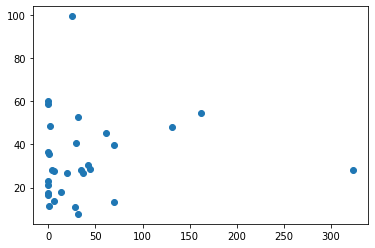

In [46]:
plt.scatter(y_test, predictions)